# PUBG玩家排名预测前数据分析及可视化

## **CONTENT :**

1. [数据准备](#1)<br>
2. [数据预处理](#2)<br>
2.1.[数据集概况和缺失值处理](#2.1)<br>
2.2.[异常值处理](#2.2)<br>
3. [数据分析与可视化](#3)<br>
3.1.[变量基本描述](#3.1)<br>
3.2.[如何取得胜利——直接相关因素（e.g. 杀敌数和总伤害等）](#3.2)<br>
3.3.[如何取得胜利——间接相关因素（辅助物品和行动方式）](#3.3)<br>
3.4. [最终结论](#3.4)<br>

<a id="1"></a> <br>
> ## **1. 数据准备**

#### 1.1 数据集选择 
pubg-finish-placement-prediction/train_V2.csv 数据集来自https://www.kaggle.com/c/pubg-finish-placement-prediction

#### 1.2 编程语言：
python3

#### 1.3 导入所需各类依赖包

In [1]:
import numpy as np 
import pandas as pd # .CSV格式数据处理 I/O (e.g. pd.read_csv)
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
import seaborn as sns
import matplotlib as ml
import matplotlib.pyplot as plt
from scipy import stats

%matplotlib inline

ml.style.use('ggplot') # 使用自带样式进行美化

<a id="2"></a> <br>
> ## **2. 数据预处理**

<a id="2.1"></a> <br>
> ### **2.1. 数据集概况和缺失值处理**

让我们先来看看该数据集的头和尾<br>

In [2]:
pbg = pd.DataFrame(pd.read_csv('train_V2.csv'))
pbg.head()

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc
0,7f96b2f878858a,4d4b580de459be,a10357fd1a4a91,0,0,0.00,0,0,0,60,...,0,0.0000,0,0.00,0,0,244.80,1,1466,0.4444
1,eef90569b9d03c,684d5656442f9e,aeb375fc57110c,0,0,91.47,0,0,0,57,...,0,0.0045,0,11.04,0,0,1434.00,5,0,0.6400
2,1eaf90ac73de72,6a4a42c3245a74,110163d8bb94ae,1,0,68.00,0,0,0,47,...,0,0.0000,0,0.00,0,0,161.80,2,0,0.7755
3,4616d365dd2853,a930a9c79cd721,f1f1f4ef412d7e,0,0,32.90,0,0,0,75,...,0,0.0000,0,0.00,0,0,202.70,3,0,0.1667
4,315c96c26c9aac,de04010b3458dd,6dc8ff871e21e6,0,0,100.00,0,0,0,45,...,0,0.0000,0,0.00,0,0,49.75,2,0,0.1875


In [3]:
pbg.tail(30)

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc
4446936,ee62630c3a17e3,cc6b1b4264eb73,269a041abb69a5,0,1,68.20,0,1,1,22,...,0,0.0,0,34.860,0,0,2708.00,7,0,0.7308
4446937,68100cdb23f1f0,9b8970931c5d00,ce5a23d8bb7883,1,2,127.40,1,1,4,31,...,0,0.0,0,0.000,0,0,1364.00,5,0,0.7111
4446938,7718e7c0c355a3,54d5ce5a79e0f6,06def1c4d808d4,0,0,0.00,0,0,0,64,...,0,0.0,0,72.210,0,0,173.10,1,0,0.0385
4446939,36b218fd209b00,195337a8c2ae1d,fa1b1885f56b7d,0,0,151.50,1,0,0,35,...,0,0.0,0,0.000,0,0,56.14,1,1539,0.3830
4446940,3eefd3ee81154a,19b7a730468b55,31045b7b933f3d,0,1,0.00,0,0,1,58,...,0,2728.0,0,0.000,0,0,1362.00,6,0,0.6250
4446941,18e04b3b452a1a,8de4310ab2d2ae,054bfeb4d51fc4,0,0,62.35,0,0,0,79,...,0,0.0,0,0.000,0,0,65.21,2,0,0.1600
4446942,2c9f1610de0ecd,d64a0663e96058,5c9254fa96f53e,0,4,724.70,6,4,14,1,...,3,5076.0,0,0.000,0,0,2162.00,8,0,1.0000
4446943,0f0dd3fe907cef,5f251817449ae7,cf837481bd01f3,0,0,0.00,0,0,0,82,...,0,0.0,0,0.000,0,0,57.59,2,0,0.1111
4446944,914aec03b107db,a8c5116da13d88,02dd2c1a0b34de,0,0,175.00,0,1,0,29,...,0,2532.0,0,0.000,0,0,1349.00,5,0,0.6875
4446945,e8b6ed3ec93a76,3e5b779bd7cf12,95e5611e58f4d5,0,0,0.00,0,0,0,81,...,0,0.0,0,0.000,0,0,57.19,1,0,0.1875


接着让我们来看看数据集中各属性的数据类型、五数概括以及缺失值情况

In [4]:
pbg.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4446966 entries, 0 to 4446965
Data columns (total 29 columns):
 #   Column           Dtype  
---  ------           -----  
 0   Id               object 
 1   groupId          object 
 2   matchId          object 
 3   assists          int64  
 4   boosts           int64  
 5   damageDealt      float64
 6   DBNOs            int64  
 7   headshotKills    int64  
 8   heals            int64  
 9   killPlace        int64  
 10  killPoints       int64  
 11  kills            int64  
 12  killStreaks      int64  
 13  longestKill      float64
 14  matchDuration    int64  
 15  matchType        object 
 16  maxPlace         int64  
 17  numGroups        int64  
 18  rankPoints       int64  
 19  revives          int64  
 20  rideDistance     float64
 21  roadKills        int64  
 22  swimDistance     float64
 23  teamKills        int64  
 24  vehicleDestroys  int64  
 25  walkDistance     float64
 26  weaponsAcquired  int64  
 27  winPoints   

下面依次给出数据集中各字段解释：
* DBNOs - 击倒敌人数量. 
* assists - 助攻数.
* boosts - 使用的能量物品数量.
* damageDealt - 总伤害.
* headshotKills - 爆头数.
* heals - 使用的治疗物品数量.
* Id - 玩家的ID.
* killPlace - 本场比赛杀敌排行.
* killPoints - Elo杀敌排名. 
* killStreaks - 连续杀敌数.
* kills - 杀敌数.
* longestKill - 最远杀敌距离.
* matchDuration - 比赛时长.
* matchId - 该场比赛id.
* matchType - 该场比赛id.
* rankPoints - Elo排名.
* revives - 救活队员的次数.
* rideDistance - 驾车距离.
* roadKills - 驾车杀敌数.
* swimDistance - 游泳杀敌数.
* teamKills - 杀死队友的次数.
* vehicleDestroys - 毁坏机动车的数量.
* walkDistance - 步行距离.
* weaponsAcquired - 收集武器的数量.
* winPoints - 收集武器的数量.
* groupId - 所处小队id.
* numGroups - 小组数量.
* maxPlace - 本局最差名次.
* winPlacePerc - 百分比排名.

接着我们来看一下数据集中各属性的五数概括：

In [5]:
pbg.describe()

,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,killPoints,kills,killStreaks,...,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc
count,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,...,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446966e+06,4.446965e+06
mean,2.338149e-01,1.106908e+00,1.307171e+02,6.578755e-01,2.268196e-01,1.370147e+00,4.759935e+01,5.050060e+02,9.247833e-01,5.439551e-01,...,1.646590e-01,6.061157e+02,3.496091e-03,4.509322e+00,2.386841e-02,7.918208e-03,1.154218e+03,3.660488e+00,6.064601e+02,4.728216e-01
std,5.885731e-01,1.715794e+00,1.707806e+02,1.145743e+00,6.021553e-01,2.679982e+00,2.746294e+01,6.275049e+02,1.558445e+00,7.109721e-01,...,4.721671e-01,1.498344e+03,7.337297e-02,3.050220e+01,1.673935e-01,9.261157e-02,1.183497e+03,2.456544e+00,7.397004e+02,3.074050e-01
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.400000e+01,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.551000e+02,2.000000e+00,0.000000e+00,2.000000e-01
50%,0.000000e+00,0.000000e+00,8.424000e+01,0.000000e+00,0.000000e+00,0.000000e+00,4.700000e+01,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.856000e+02,3.000000e+00,0.000000e+00,4.583000e-01
75%,0.000000e+00,2.000000e+00,1.860000e+02,1.000000e+00,0.000000e+00,2.000000e+00,7.100000e+01,1.172000e+03,1.000000e+00,1.000000e+00,...,0.000000e+00,1.909750e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.976000e+03,5.000000e+00,1.495000e+03,7.407000e-01
max,2.200000e+01,3.300000e+01,6.616000e+03,5.300000e+01,6.400000e+01,8.000000e+01,1.010000e+02,2.170000e+03,7.200000e+01,2.000000e+01,...,3.900000e+01,4.071000e+04,1.800000e+01,3.823000e+03,1.200000e+01,5.000000e+00,2.578000e+04,2.360000e+02,2.013000e+03,1.000000e+00


In [6]:
pbg.isnull().sum()

Id                 0
groupId            0
matchId            0
assists            0
boosts             0
damageDealt        0
DBNOs              0
headshotKills      0
heals              0
killPlace          0
killPoints         0
kills              0
killStreaks        0
longestKill        0
matchDuration      0
matchType          0
maxPlace           0
numGroups          0
rankPoints         0
revives            0
rideDistance       0
roadKills          0
swimDistance       0
teamKills          0
vehicleDestroys    0
walkDistance       0
weaponsAcquired    0
winPoints          0
winPlacePerc       1
dtype: int64

显然，从上面的缺省值情况可以看出，数据集看起来很好，除了winPlacePerc中有一个缺省值，其余都没有。同时**因为它是用户特定的值**，我们不能按照

一般的缺省值处理去估计/猜测它，所以直接删除winPlacePerc中的缺少值。

In [7]:
# creating a copy
pg = pbg.copy()

In [8]:
pg[pg.winPlacePerc.isnull()]

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,revives,rideDistance,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc
2744604,f70c74418bb064,12dfbede33f92b,224a123c53e008,0,0,0.0,0,0,0,1,...,0,0.0,0,0.0,0,0,0.0,0,0,NaN


In [9]:
pg.dropna(axis=0, inplace=True)

再来测试一下删除缺省值的效果：

In [10]:
pbg = pg
pbg.isnull().sum()

Id                 0
groupId            0
matchId            0
assists            0
boosts             0
damageDealt        0
DBNOs              0
headshotKills      0
heals              0
killPlace          0
killPoints         0
kills              0
killStreaks        0
longestKill        0
matchDuration      0
matchType          0
maxPlace           0
numGroups          0
rankPoints         0
revives            0
rideDistance       0
roadKills          0
swimDistance       0
teamKills          0
vehicleDestroys    0
walkDistance       0
weaponsAcquired    0
winPoints          0
winPlacePerc       0
dtype: int64

<a id="2.2"></a> <br>
> ### **2.2. 异常值处理**

一些行中的数据统计出来的结果非常反常规，那么这些玩家肯定有问题，为了后续训练模型的准确性，我们会把这些异常数据剔除

例如识别出玩家在游戏中有击杀数，但是全局没有移动；这类型玩家肯定是存在异常情况（挂机），我们把这些玩家删除。

* 异常值处理：删除玩家在游戏中有击杀数，但是全局没有移动

In [11]:
# 创建新变量，统计玩家移动距离
pbg['totalDistance'] = pbg['rideDistance'] + pbg['walkDistance'] + pbg['swimDistance']

In [12]:
# 创建新变量，统计玩家是否在游戏中，有击杀，但是没有移动，如果是返回True, 否则返回false
pbg['killsWithoutMoving'] = ((pbg['kills'] > 0) & (pbg['totalDistance'] == 0))
pbg["killsWithoutMoving"].head()

0    False
1    False
2    False
3    False
4    False
Name: killsWithoutMoving, dtype: bool

In [13]:
pbg.head()

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc,totalDistance,killsWithoutMoving
0,7f96b2f878858a,4d4b580de459be,a10357fd1a4a91,0,0,0.00,0,0,0,60,...,0,0.00,0,0,244.80,1,1466,0.4444,244.8000,False
1,eef90569b9d03c,684d5656442f9e,aeb375fc57110c,0,0,91.47,0,0,0,57,...,0,11.04,0,0,1434.00,5,0,0.6400,1445.0445,False
2,1eaf90ac73de72,6a4a42c3245a74,110163d8bb94ae,1,0,68.00,0,0,0,47,...,0,0.00,0,0,161.80,2,0,0.7755,161.8000,False
3,4616d365dd2853,a930a9c79cd721,f1f1f4ef412d7e,0,0,32.90,0,0,0,75,...,0,0.00,0,0,202.70,3,0,0.1667,202.7000,False
4,315c96c26c9aac,de04010b3458dd,6dc8ff871e21e6,0,0,100.00,0,0,0,45,...,0,0.00,0,0,49.75,2,0,0.1875,49.7500,False


可以看到最后两列列出了总移动距离和是否存在 有击杀但没有移动 的情况

In [14]:
# 检查是否存在有击杀但是没有移动的数据
pbg[pbg['killsWithoutMoving'] == True].shape

(1535, 31)

In [15]:
pbg[pbg['killsWithoutMoving'] == True][['killsWithoutMoving']].head()

,killsWithoutMoving
1824,True
6673,True
11892,True
14631,True
15591,True


In [16]:
# 删除这些数据
pbg.drop(pbg[pbg['killsWithoutMoving'] == True].index, inplace=True)

In [17]:
# 再次检查
pbg[pbg['killsWithoutMoving'] == True].shape

(0, 31)

* 异常值处理：删除驾车杀敌数异常的数据

In [18]:
# 查看驾车杀敌数超过十个的玩家，因为一般我们认为驾车杀敌非常困难
pbg[pbg['roadKills'] > 10]

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,roadKills,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc,totalDistance,killsWithoutMoving
2733926,c3e444f7d1289f,489dd6d1f2b3bb,4797482205aaa4,0,0,1246.0,0,0,0,1,...,14,5.297,0,0,1277.0,0,1371,0.4286,1282.302,False
2767999,34193085975338,bd7d50fa305700,a22354d036b3d6,0,0,1102.0,0,0,0,1,...,11,0.000,0,0,816.6,5,1533,0.4713,4934.600,False
2890740,a3438934e3e535,1081c315a80d14,fe744430ac0070,0,8,2074.0,0,1,11,1,...,18,0.000,0,0,3150.0,4,1568,1.0000,5876.000,False
3524413,9d9d044f81de72,8be97e1ba792e3,859e2c2db5b125,0,3,1866.0,0,5,7,1,...,11,0.000,0,0,1041.0,10,1606,0.9398,7853.000,False


In [19]:
# 删除这些数据
pbg.drop(pbg[pbg['roadKills'] > 10].index, inplace=True)
pbg.shape

(4445426, 31)

* 异常值处理：删除玩家在一局中杀敌数超过30人的数据<br>

  首先绘制一下玩家杀敌数

In [20]:
temp = pbg['kills'].value_counts().sort_values(ascending=False)

print("Total number of states : ",len(temp))
trace = go.Bar(
    x = temp.index,
    y = (temp),
    marker=dict(color='crimson', line=dict(color='black', width=1.5), opacity=0.75)
)
data = [trace]
layout = go.Layout(title = "",
                   xaxis=dict(title='kills', tickfont=dict(size=14, color='rgb(107, 107, 107)')
                             ),
                   yaxis=dict(title='Count of kills', titlefont=dict(size=16, color='rgb(107, 107, 107)'),
                              tickfont=dict(size=14, color='rgb(107, 107, 107)')),
                   bargap=0.2, bargroupgap=0.1, paper_bgcolor='rgb(243, 243, 243)', 
                   plot_bgcolor="rgb(243, 243, 243)")

fig = go.Figure(data=data, layout=layout)
iplot(fig)

Total number of states :  58


In [21]:
# 找出杀敌数大于30
pbg[pbg['kills'] > 30].shape

(95, 31)

In [22]:
pbg[pbg['kills'] > 30][['kills']].head()

,kills
57978,35
87793,31
156599,48
160254,42
180189,35


In [23]:
# 删除上述异常数据
pbg.drop(pbg[pbg['kills'] > 30].index, inplace=True)

In [24]:
temp = pbg['kills'].value_counts().sort_values(ascending=False)

print("Total number of states : ", len(temp))
trace = go.Bar(
    x = temp.index,
    y = (temp),
    marker=dict(color='crimson', line=dict(color='black', width=1.5), opacity=0.75)
)
data = [trace]
layout = go.Layout(title = "",
                   xaxis=dict(title='kills', tickfont=dict(size=14, color='rgb(107, 107, 107)')
                             ),
                   yaxis=dict(title='Count of kills', titlefont=dict(size=16, color='rgb(107, 107, 107)'),
                              tickfont=dict(size=14, color='rgb(107, 107, 107)')),
                   bargap=0.2, bargroupgap=0.1, paper_bgcolor='rgb(243, 243, 243)', 
                   plot_bgcolor="rgb(243, 243, 243)")

fig = go.Figure(data=data, layout=layout)
iplot(fig)

Total number of states :  31


* 异常值处理：删除爆头率异常数据

  如果一个玩家的击杀爆头率过高，也说明其有问题

In [25]:
# 创建变量爆头率
pbg['headshot_rate'] = pbg['headshotKills'] / pbg['kills']
pbg['headshot_rate'] = pbg['headshot_rate'].fillna(0.0)
pbg["headshot_rate"].tail()

4446961    0.0
4446962    0.0
4446963    0.0
4446964    0.5
4446965    0.0
Name: headshot_rate, dtype: float64

In [26]:
pbg.head()

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc,totalDistance,killsWithoutMoving,headshot_rate
0,7f96b2f878858a,4d4b580de459be,a10357fd1a4a91,0,0,0.00,0,0,0,60,...,0.00,0,0,244.80,1,1466,0.4444,244.8000,False,0.0
1,eef90569b9d03c,684d5656442f9e,aeb375fc57110c,0,0,91.47,0,0,0,57,...,11.04,0,0,1434.00,5,0,0.6400,1445.0445,False,0.0
2,1eaf90ac73de72,6a4a42c3245a74,110163d8bb94ae,1,0,68.00,0,0,0,47,...,0.00,0,0,161.80,2,0,0.7755,161.8000,False,0.0
3,4616d365dd2853,a930a9c79cd721,f1f1f4ef412d7e,0,0,32.90,0,0,0,75,...,0.00,0,0,202.70,3,0,0.1667,202.7000,False,0.0
4,315c96c26c9aac,de04010b3458dd,6dc8ff871e21e6,0,0,100.00,0,0,0,45,...,0.00,0,0,49.75,2,0,0.1875,49.7500,False,0.0


In [27]:
pbg[(pbg['headshot_rate'] == 1) & (pbg['kills'] > 9)].shape

(24, 32)

In [28]:
pbg[(pbg['headshot_rate'] == 1) & (pbg['kills'] > 9)].head()

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc,totalDistance,killsWithoutMoving,headshot_rate
281570,ab9d7168570927,add05ebde0214c,e016a873339c7b,2,3,1212.0,8,10,0,1,...,0.0,0,0,2939.0,5,0,0.8462,2939.0,False,1.0
346124,044d18fc42fc75,fc1dbc2df6a887,628107d4c41084,3,5,1620.0,13,11,3,1,...,0.0,0,0,3422.0,8,1560,1.0000,8142.0,False,1.0
871244,e668a25f5488e3,5ba8feabfb2a23,f6e6581e03ba4f,0,4,1365.0,9,13,0,1,...,0.0,0,0,2105.0,5,1587,1.0000,2105.0,False,1.0
908815,566d8218b705aa,a9b056478d71b2,3a41552d553583,2,5,1535.0,10,10,3,1,...,0.0,2,0,2761.0,7,1519,0.9630,7948.0,False,1.0
963463,1bd6fd288df4f0,90584ffa22fe15,ba2de992ec7bb8,2,6,1355.0,12,10,2,1,...,0.0,0,0,2458.0,4,1562,1.0000,3476.0,False,1.0


In [29]:
pbg.drop(pbg[(pbg['headshot_rate'] == 1) & (pbg['kills'] > 9)].index, inplace=True)

In [30]:
# 再次检查
pbg[(pbg['headshot_rate'] == 1) & (pbg['kills'] > 9)].shape

(0, 32)

* 异常值处理：删除关于运动距离的异常值

In [31]:
# 距离整体描述
pbg[['walkDistance', 'rideDistance', 'swimDistance', 'totalDistance']].describe()

,walkDistance,rideDistance,swimDistance,totalDistance
count,4.445307e+06,4.445307e+06,4.445307e+06,4.445307e+06
mean,1.154618e+03,6.063215e+02,4.510898e+00,1.765451e+03
std,1.183508e+03,1.498561e+03,3.050733e+01,2.183246e+03
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.554000e+02,0.000000e+00,0.000000e+00,1.584000e+02
50%,6.863000e+02,0.000000e+00,0.000000e+00,7.892600e+02
75%,1.977000e+03,2.569500e-01,0.000000e+00,2.729000e+03
max,2.578000e+04,4.071000e+04,3.823000e+03,4.127010e+04


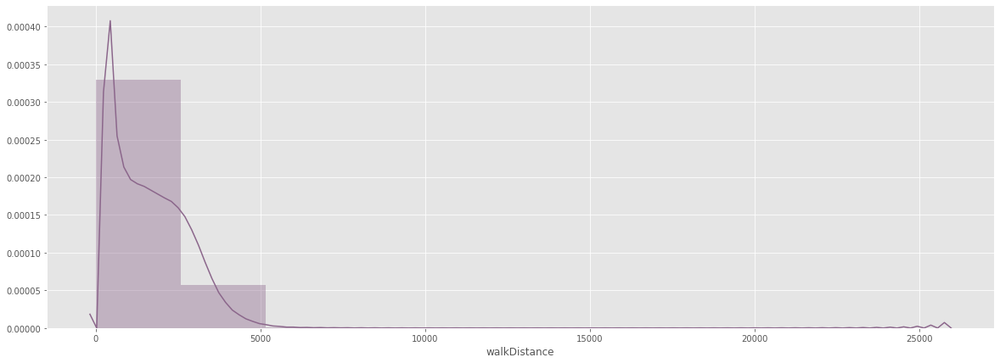

In [32]:
# 行走距离处理
plt.figure(figsize=(20,7))
sns.distplot(pbg['walkDistance'], bins=10, color='#8B668B')
plt.show()

In [33]:
pbg[pbg['walkDistance'] >= 10000].shape

(219, 32)

In [34]:
pbg[pbg['walkDistance'] >= 10000][['walkDistance']].head()

,walkDistance
23026,13530.0
34344,10030.0
49312,12410.0
68590,11590.0
94400,10440.0


删除行走距离超过10000的数据，行走距离超过10000显然是不可能的

In [35]:
pbg.drop(pbg[pbg['walkDistance'] >= 10000].index, inplace=True)

In [36]:
# 再次检查
pbg[pbg['walkDistance'] >= 10000].shape

(0, 32)

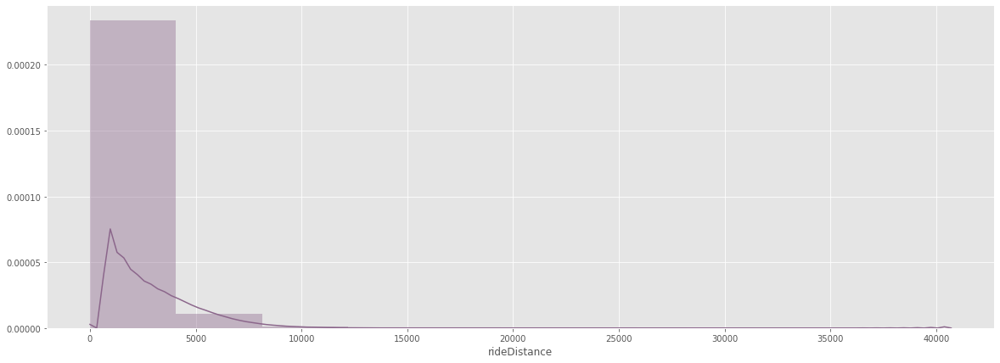

In [37]:
# 驾车行驶距离处理
plt.figure(figsize=(20,7))
sns.distplot(pbg['rideDistance'], bins=10, color='#8B668B')
plt.show()

In [38]:
pbg[pbg['rideDistance'] >= 20000].shape

(150, 32)

In [39]:
pbg[pbg['rideDistance'] >= 20000][['rideDistance']].head()

,rideDistance
28588,25930.0
63015,21880.0
70507,28450.0
72763,20510.0
95276,25810.0


删除驾车距离超过20000的数据，同样驾车距离超过20000显然是不可能的

In [40]:
pbg.drop(pbg[pbg['rideDistance'] >= 20000].index, inplace=True)

In [41]:
# 再次检查
pbg[pbg['rideDistance'] >= 20000].shape

(0, 32)

同上处理游泳距离处理，删除游泳距离超过20000的数据，游泳距离超过20000显然也是不可能的

In [42]:
pbg[pbg['swimDistance'] >= 2000].shape

(12, 32)

In [43]:
pbg[pbg['swimDistance'] >= 2000][['swimDistance']].head()

,swimDistance
177973,2295.0
274258,2148.0
1005337,2718.0
1195818,2668.0
1227362,3823.0


In [44]:
pbg.drop(pbg[pbg['swimDistance'] >= 2000].index, inplace=True)

In [45]:
pbg[pbg['rideDistance'] >= 20000].shape

(0, 32)

* 异常值处理：武器收集异常值处理

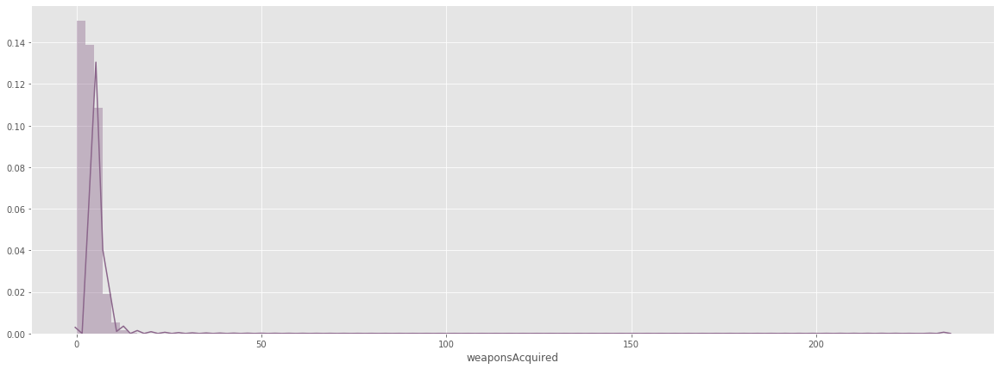

In [46]:
plt.figure(figsize=(20,7))
sns.distplot(pbg['weaponsAcquired'], bins=100, color='#8B668B')
plt.show()

In [47]:
pbg[pbg['weaponsAcquired'] >= 80].shape

(19, 32)

In [48]:
pbg[pbg['weaponsAcquired'] >= 80][['weaponsAcquired']].head()

,weaponsAcquired
233643,128
588387,80
1437471,102
1449293,95
1592744,94


In [49]:
pbg.drop(pbg[pbg['weaponsAcquired'] >= 80].index, inplace=True)

In [50]:
# 再次检查
pbg[pbg['weaponsAcquired'] >= 80].shape

(0, 32)

* 异常值处理：删除使用治疗药品数量异常值

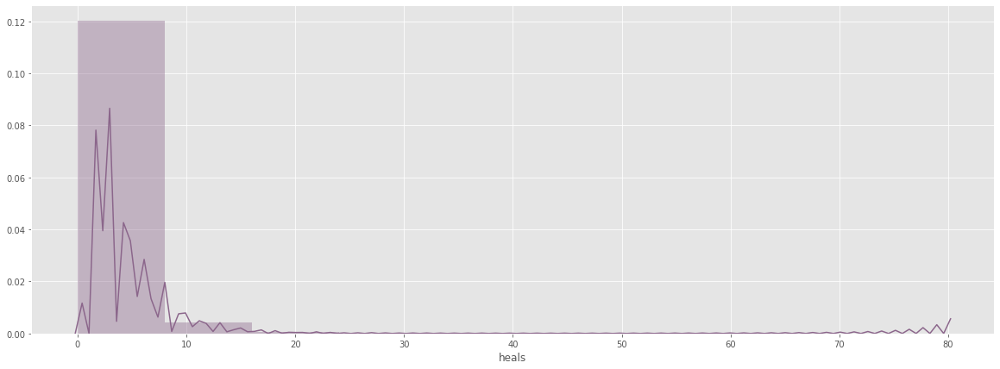

In [51]:
plt.figure(figsize=(20, 7))
sns.distplot(pbg['heals'], bins=10, color='#8B668B')
plt.show()

In [52]:
pbg[pbg['heals'] >= 40].shape

(135, 32)

In [53]:
pbg[pbg['heals'] >= 40][["heals"]].head()

,heals
18405,47
54463,43
126439,52
259351,42
268747,48


In [54]:
pbg.drop(pbg[pbg['heals'] >= 40].index, inplace=True)

In [55]:
pbg[pbg['heals'] >= 40].shape

(0, 32)

<a id="3"></a> <br>
> ## **3. 数据分析及可视化**

<a id="3.1"></a> <br>
> ### **3.1. 变量的基本描述**

* `id`、`matchId`、`groupId`的区别<br>
 
  前面给出了数据描述，**matchId**是该场比赛的Id，**groupId**是所处小组的Id

In [56]:
pbg[pbg['groupId']=='4d4b580de459be']

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc,totalDistance,killsWithoutMoving,headshot_rate
0,7f96b2f878858a,4d4b580de459be,a10357fd1a4a91,0,0,0.00,0,0,0,60,...,0.0,0,0,244.80,1,1466,0.4444,244.80,False,0.00
903525,7516514fbd1091,4d4b580de459be,a10357fd1a4a91,0,0,0.00,0,0,0,62,...,0.0,0,0,48.28,1,1465,0.4444,48.28,False,0.00
1912681,c56d45be16aa86,4d4b580de459be,a10357fd1a4a91,0,0,318.00,2,1,0,6,...,0.0,0,0,342.80,2,1476,0.4444,342.80,False,0.25
2383840,100eef17c4d773,4d4b580de459be,a10357fd1a4a91,0,0,90.75,0,0,0,61,...,0.0,0,0,96.08,1,1498,0.4444,96.08,False,0.00


In [57]:
len(pbg[pbg['matchId']=='a10357fd1a4a91'])

96

考虑一下上面的例子。在这两种情况下，Id不同，但groupId和matchId是相同的。这也说明了，Id为7f96b2f878858a的人A和Id为7516514fbd1091的人

B是朋友，并有一个团队(groupId)，然后他们完成了相同的比赛，因此可以猜想他们是使用相同的matchId进入游戏。

In [58]:
temp = pbg[pbg['matchId']=='a10357fd1a4a91']['groupId'].value_counts().sort_values(ascending=False)
print("Total number of states : ",len(temp))

def get_color(c):
    if(c > 7):
        return 'rgb(1,15,139)'
    elif(c > 6):
        return 'rgb(10,77,131)'
    elif(c > 4):
        return 'rgb(49,54,149)'
    elif(c > 3):
        return 'rgb(69,117,180)'
    elif(c > 2):
        return 'rgb(171,217,233)'
    elif(c > 1):
        return 'rgb(253,174,97)'
    else:
        return 'rgb(254,224,144)'
trace = go.Bar(
    x = temp.index,
    y = (temp),
    marker_color=[get_color(c) for c in temp],
    marker=dict(line=dict(color='black', width=2), opacity=0.75)
)
data = [trace]
layout = go.Layout(
    title = "GroupId of Match Id: a10357fd1a4a91",
    xaxis=dict(
        title='groupId',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count of groupId of type of MatchId a10357fd1a4a91',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
),
    bargap=0.2,
    bargroupgap=0.1, paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor="rgb(243, 243, 243)"
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

Total number of states :  26


可以注意到，你可以看到一些奇怪的值得计数。团队成员最多有四个人，这里因为我不知道超过四个人意味着什么所以看了看游戏评论，有游戏玩家评论到无论

在何种模式下，一组玩家的数量通常都会超过预期的最大数量。例如，在matchType == 'squad'下，你可能有超过4个人在一个小组中，这是由于在游戏中断

开连接造成的。当断开连接发生时，多个组的玩家存储在API的数据库中，最终位置相同。这样做的结果是，当我从最终位置创建groupId特性时，会发现有太

多的组。所以可以将groupId理解为“最终位置相同的玩家”，而不是“绝对在一起玩的玩家”。

* 接下来看看对于`assists`的数据描述

熟悉这个游戏的玩家知道，这个游戏可以简单概括为，拿起你的武器，四处走动，杀死敌人，活到最后。所以这里对一些变量进行详细的数据描述：<br>

assists：助攻的意思是我不杀死敌人，而是帮助杀死敌人。所以当你关注该变量时，也有一个杀死。换句话说，如果我杀死了敌人 `kill + 1`。但是如果我

不是杀死敌人而是帮助杀死敌人 `assists + 1`

In [59]:
temp = pbg['assists'].value_counts().sort_values(ascending=False)

print("Total number of states : ",len(temp))
trace = go.Bar(
    x = temp.index,
    y = (temp),
    marker=dict(color='crimson', line=dict(color='black', width=1.5), opacity=0.75)
)
data = [trace]
layout = go.Layout(
    title = "",
    xaxis=dict(
        title='assists',
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
    ),
    yaxis=dict(
        title='Count of assists',
        titlefont=dict(
            size=16,
            color='rgb(107, 107, 107)'
        ),
        tickfont=dict(
            size=14,
            color='rgb(107, 107, 107)'
        )
),
    bargap=0.2,
    bargroupgap=0.1, paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor="rgb(243, 243, 243)"
)
fig = go.Figure(data=data, layout=layout)
iplot(fig)

Total number of states :  17


从上图可以看出，助攻数增加玩家数减少

<a id="3.2"></a> <br>
> ### **3.2. 如何取得胜利——直接相关因素（e.g. 杀敌数和总伤害等）**

* 首先我们用热图来大致了解相关特征:

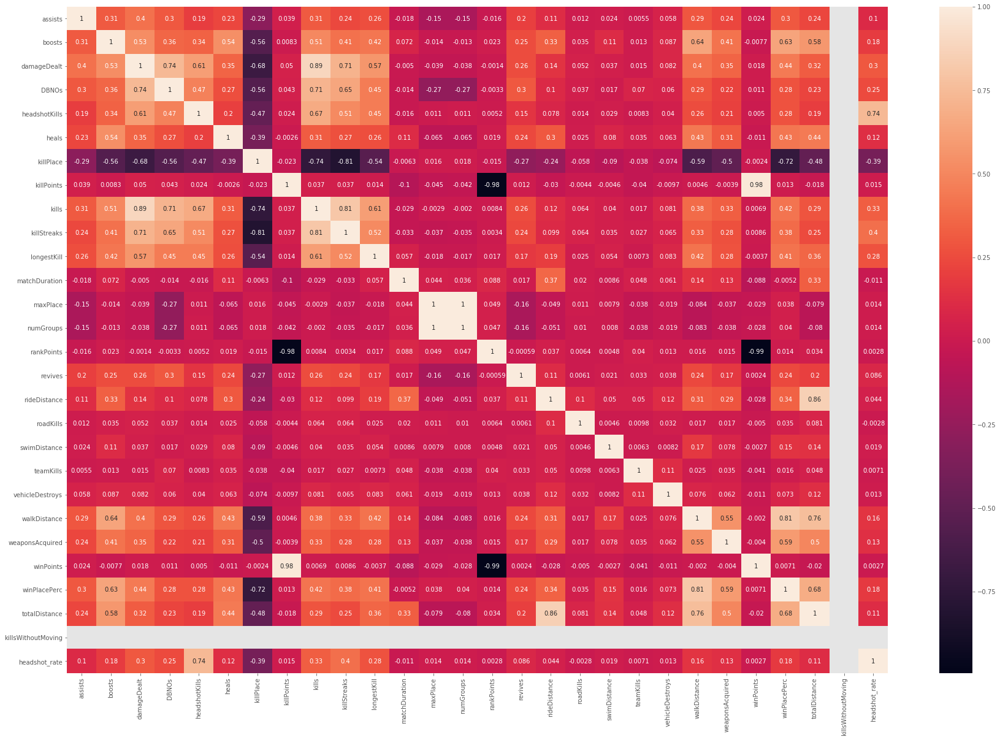

In [60]:
plt.figure(figsize=(30, 20))
sns.heatmap(pbg.corr(), annot=True)
plt.show()

显然从热力图中我们可以看到颜色越深代表代表两个属性之间的相关性程度越高，比如很好理解的 **杀敌数(kills)** 和 **连续杀敌数(killStreaks)**

两个属性与 **本场杀敌排行(killPlace)** 之间的相关性程度分别为0.73和0.81；同时 **Elo排名(RankPoints)** 和 **胜率Elo排名

(winPoints)** 的相关性高达0.99。

##### 根据上述的热力图简单总结：
*  'kills'与'damageDealt'和'killPlace'，'DBNOs'，'headshotKills'，'killStreaks'，'longestKills'高度相关，而与'winPlacePerc'相关性较低。
*  'winPlacePerc'与'walkDistance'，'weaponsAcquired'，'boosts'高度相关，而与'damageDealt'，'kills'和'heals'相关度较低。
*  'killPoints'与'winPoints'高度相关.

* 与`kills`相关的变量

* 接下来我们思考杀敌数与胜利的关系：它们是相互依存的吗？<br>

  我们从以下点进行分析：<br>
  1、杀敌数越多才会赢吗?<br>
  2、伤害与杀敌数成比例吗?<br>
  3、更多的伤害意味着更好的胜利吗?<br>
  

* 赢/输 比赛的杀敌数:

In [61]:
pw = pbg[pbg['winPlacePerc'] == 1]
pl = pbg[pbg['winPlacePerc'] == 0]

In [62]:
trace = go.Histogram(x=pw.kills,
                     marker=dict(color="crimson", line=dict(color='black', width=2)),
                     opacity=0.75)
layout = go.Layout(title='NO. OF MATCHES WON V/S NO. OF KILLS',
                   xaxis=dict(
                       title='WON'
                   ),
                   yaxis=dict(
                       title='Count'
                   ),
    bargap=0.2,
    bargroupgap=0.1, paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor="rgb(243, 243, 243)")

fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

In [63]:
trace = go.Histogram(x=pl.kills,
                     marker=dict(color="crimson", line=dict(color='black', width=2)),
                     opacity=0.75)
layout = go.Layout(title='NO. OF MATCHES LOST V/S NO. OF KILLS',
                   xaxis=dict(
                       title='WON'
                   ),
                   yaxis=dict(
                       title='Count'
                   ),
    bargap=0.2,
    bargroupgap=0.1, paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor="rgb(243, 243, 243)")

fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

我们得出以下结论:<br>

1、大部分的比赛胜利百分比有非常低的杀死计数(0-3)<br>
2、大部分的比赛失败百分比是杀死计数==0<br>

然而，由于在整个比赛中都没有杀死对手，所以输掉比赛比赢下比赛更常见<br>

随着杀敌数次数的增加，我们看到，我们需要一个像样的杀敌数来赢得一场比赛(杀死大于3个)，即杀死<=2更容易失败。
所以，我们可以得出否定的结论。杀敌数量与赢/输有很低但很明确的相关性。杀死<=2的玩家更容易输掉比赛。

下面我们主要关注一下，与`kills`相关的变量`headshotKills` `killStreaks` `longestKill` `roadKills` `teamKills`的情况

In [64]:
# Related variables with kills
temp1 = pbg['headshotKills'].value_counts().sort_values(ascending=False)
temp2 = pbg['killStreaks'].value_counts().sort_values(ascending=False)
temp3 = pbg['longestKill'].value_counts().sort_values(ascending=False)
temp4 = pbg['roadKills'].value_counts().sort_values(ascending=False)
temp5 = pbg['teamKills'].value_counts().sort_values(ascending=False)
temp6 = pbg['kills'].value_counts().sort_values(ascending=False)

trace1 = go.Scatter(x = temp1.index, y = (temp1), mode = "markers", name = "headshotKills",
                    marker = dict(color='rgba(28, 149, 249, 0.8)', size=8))
trace2 = go.Scatter(x = temp2.index, y = (temp2), mode = "markers", name = "killStreaks",
                    marker = dict(color='rgba(249, 94, 28, 0.8)', size=8))
trace3 = go.Scatter(x = temp3.index, y = (temp3), mode = "markers", name = "longestKill",
                    marker = dict(color='rgba(150, 26, 80, 0.8)', size=8))
trace4 = go.Scatter(x = temp4.index, y = (temp4), mode = "markers", name = "roadKills",
                    marker = dict(color='lime', size=8))
trace5 = go.Scatter(x = temp5.index, y = (temp5), mode = "markers", name = "teamKills",
                    marker = dict(color='crimson', size=8))
trace6 = go.Scatter(x = temp6.index, y = (temp6), mode = "markers", name = "kills",
                    marker = dict(color='rgb(188,145,202)', size=8))

data = [trace1, trace2, trace3, trace4, trace5, trace6]
layout = dict(title = 'Related variables with kills',
              xaxis = dict(title='Related variables with kills', ticklen=5, zeroline=False, zerolinewidth=1, gridcolor="white"),
              yaxis = dict(title='Count of Related variables', ticklen= 5, zeroline= False, zerolinewidth=1, gridcolor="white",),
              paper_bgcolor='rgb(243, 243, 243)',
              plot_bgcolor='rgb(243, 243, 243)',
             )
fig = dict(data=data, layout=layout)
iplot(fig)

从上图可以看出，与`kills`相类似的几个设计杀敌数的属性与kills的分布是大致相同的，杀敌数（爆头、连续杀敌、远距离杀敌、驾车杀敌数、团队杀敌

数）越多的玩家数量越少。

下面我们主要关注一下，与`kills`相关的变量`damageDealt` `damageDealt`的情况，重点关注杀敌数与胜率和总伤害之间的关系

In [65]:
# 由于数据集数据量大，这里随机从数据集中取1000个数据
df = pbg.sample(n=1000,random_state=123,axis=0)
df.head()

,Id,groupId,matchId,assists,boosts,damageDealt,DBNOs,headshotKills,heals,killPlace,...,swimDistance,teamKills,vehicleDestroys,walkDistance,weaponsAcquired,winPoints,winPlacePerc,totalDistance,killsWithoutMoving,headshot_rate
1024528,8f2c61e830e988,8f359726e97c59,f9954e8cdb44d4,0,11,386.90,2,0,5,7,...,0.0,0,0,1440.0,4,0,0.7037,1440.0,False,0.0
3191318,eec3b31477cc4d,143c56ae33a773,e38b359b209f2c,0,0,285.00,0,1,0,20,...,0.0,0,0,150.2,4,1493,0.4124,150.2,False,0.5
981650,4f63163f527882,36770936c8d7b6,bbe1c21424002f,1,3,55.33,1,1,1,24,...,0.0,0,0,2709.0,10,0,0.8846,3608.8,False,1.0
1403618,6ff393b370ae56,aa7a2fc5cb3dd1,43a98b1720fc96,0,0,0.00,0,0,0,93,...,0.0,0,0,0.0,0,1450,0.0000,0.0,False,0.0
1480346,5b34ca1919e4ca,bb30eb69d044d2,990962984fd40a,0,1,37.73,0,0,1,65,...,0.0,0,0,1248.0,6,1524,0.4643,1852.5,False,0.0


In [66]:
df2 = df.loc[:,["damageDealt", "kills", "winPlacePerc"]]
df2["index"] = np.arange(1, len(df)+1)

# 散点图矩阵
fig = ff.create_scatterplotmatrix(df2, diag='box', index='index', colormap='YlOrRd',
                                  colormap_type='seq', height=1000, width=1200)
iplot(fig)

上面的散点图矩阵中可以看到，`kills`和`damageDealt`（杀敌数和总伤害）的散点图（第一列第二个图）中，两个变量基本上呈现线性关系，即杀敌数越

多，总伤害越高；而`kills`、`damageDealt`与`winPlacePerc`的关系就不在是我们常规上认为的，杀敌数和总伤害越高则胜率越高，但是若胜率高相对

应总伤害和杀敌数就会高，这也许与前面提到的团队协作有关（毕竟这个游戏在个别形式上还是一个团队游戏）。

* 关注一下胜率的数据分布：

In [67]:
wins_modr_best = []
for val in list(pbg.winPlacePerc.unique()):
    if val > 0.45:
        wins_modr_best.append(val)
    else:
        continue
print(pbg.winPlacePerc.nunique())
print(pd.Series(wins_modr_best).nunique())

3000
1650


* 在观察到的人中，有一半多一点人的胜率超过50%(1表示胜率100%，0表示胜率0%)，那么来看看胜率情况分布：

In [68]:
winner = pbg[pbg.winPlacePerc==1]
loser = pbg[pbg.winPlacePerc==0]

fig = go.Figure(data=[go.Pie(labels=['Won','Lost','Drew/Others'],
                             values=[winner.shape[0], loser.shape[0], 
                                     pbg.shape[0] - (winner.shape[0] + loser.shape[0])])])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(line=dict(color='#000000', width=2)))
iplot(fig)

鼠标hover上面的饼图可以看到，胜率100%的玩家数为127313，仅占2.86%；胜率0%的玩家也就是所有比赛都失败的玩家数位220313，占4.96%；其余胜率的

玩家占比最高，为92.2%，这样看来大多数玩家还是普通人，胜率100%的玩家确实是少数精英玩家。

* 同样的来看看玩家选择比赛的类型（即小组人数）：

In [69]:
match_types = list(pbg.matchType.value_counts().values)
labels = list(pbg.matchType.value_counts().index)

# Plot a pie chart to show which game type is more popular
fig = go.Figure(data=[go.Pie(labels=labels, values=match_types, hole=.3)])
fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
                  marker=dict(line=dict(color='#000000', width=2)))
iplot(fig)

通过上图所以我们可以得出结论，**squad-fpp(四人组队第一视角)**是最受欢迎的比赛类型，其次是**duo-fpp(两人组队第一视角)**。**normal-duo**是最不常用的游戏类型。

* 那么我们思考一个问题，比赛的类型会影响胜率吗?

In [70]:
for_win = list(pw.matchType.value_counts().values)
for_loss = list(pl.matchType.value_counts().values)

fig = go.Figure(data=[
    go.Bar(name='WON', marker=dict(color='rgb(69,117,180)'), x=list(pw.matchType.values), y=for_win),
    go.Bar(name='LOST', marker=dict(color='rgba(150, 26, 80, 0.8)'), x=list(pl.matchType.values), y=for_loss)
])
# Change the bar mode
fig.update_layout(barmode='group')
iplot(fig)

通过观察，可以得到结论:

1、虽然**squad-fpp**是最受欢迎的比赛类型，但它也有更多的损失。<br>
2、**duo-fpp**是第二受欢迎的比赛类型，没有出现比赛失败的情况。<br>
3、**squad**是第三大最受欢迎的比赛类型，但是相比于**squad-fpp**赢得比赛的记录比输了的记录更多。<br>
4、**duo**是一种不受欢迎的比赛类型，事实证明这是合理的，因为大部分都带来了失败。<br>

* 找出`kills`和`wins`的关系

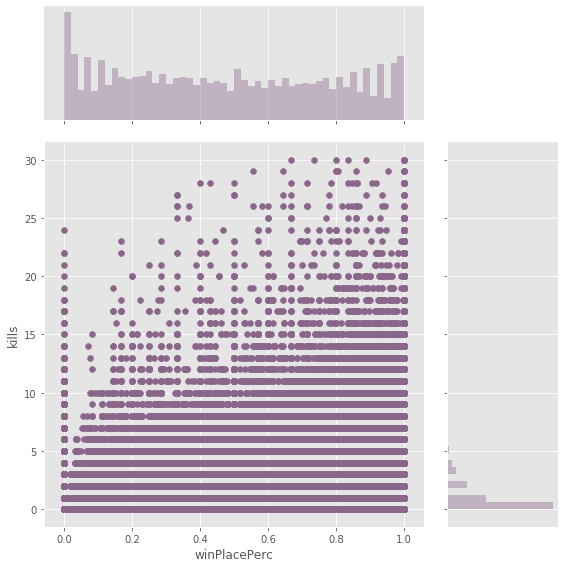

In [71]:
sns.jointplot(x="winPlacePerc", y="kills", data=pbg, height=8, ratio=3, color="#8B668B")
plt.show()

通过观察，可以得到结论:

1、**winPlacePerc**和**kills**是中度相关的。因此，从之前的热力图中获得的信息是合理的。<br>
2、为了获得胜利，获取一些技能是绝对必要的(阈值=3)，而不是躺下来掩盖和隐藏。<br>
3、不能以较低的杀戮为目标。当然更高的杀戮确实证明了玩家的技能并保证了更高的获胜机会。<br>

* 如果胜利者的杀敌数很低时，那么应该关注伤害来得分吗?

  1、找到杀敌数的伤害指标。<br>
  2、找出比赛失败的伤害指标。<br>

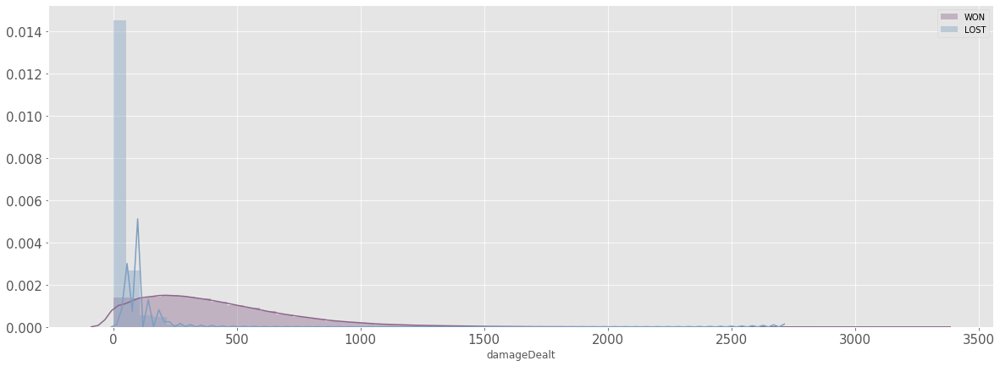

In [72]:
plt.figure(figsize=(20, 7))
sns.distplot(pw['damageDealt'], color="#8B668B")
sns.distplot(pl['damageDealt'], color="#7D9EC0")
plt.legend(['WON','LOST'])
plt.tick_params(labelsize=15)
plt.show()

通过观察，可以得到结论:

1、就最小的总伤害而言，输掉一场比赛的可能性要比赢得一场比赛的可能性高。<br>
2、对于赢了的比赛，最大的总伤害是在3400左右。<br>
3、对于输了的比赛，最大的总伤害发生在2700左右。<br>
4、如果玩家总伤害少，他们更容易输掉比赛。<br>

所以，我们可以得出这样的结论，伤害的数量与获胜的关系很低。

* 找到`damageDealt`和`winPlacePerc`的关系

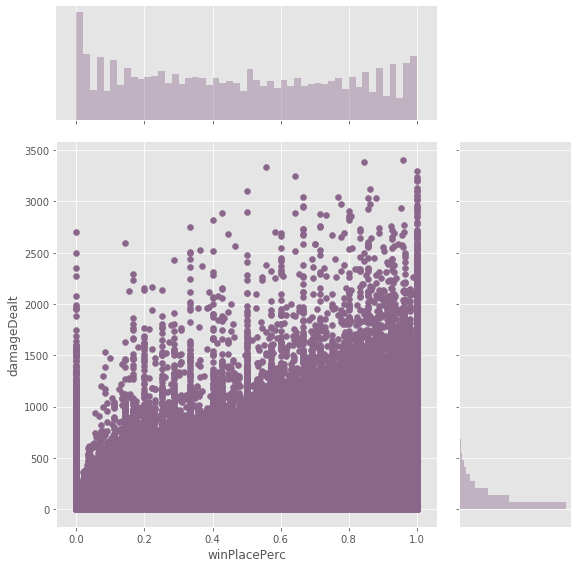

In [73]:
sns.jointplot(x="winPlacePerc", y="damageDealt", data=pbg, height=8, ratio=3, color="#8B668B")
plt.show()

通过观察，可以得到结论:

1、`winPlacePerc`和`damageDealt`是中度相关的。因此，从热图中获得的信息是合理的。<br>
2、为了赢得比赛，对敌人造成伤害是绝对必要的，因为这是PUBG游戏中最重要的得分点之一。它揭示了一个玩家的技能。<br>
3、如果玩家没有造成足够的伤害来获得分数，他们更容易输掉游戏。<br>

* 那么有多少玩家在没有杀戮和伤害的情况下赢得了他们的游戏?

  隐藏（在游戏中藏好直至游戏结束）仍然是传统的**damage-kill-cover**策略的有效对抗方法吗?

In [74]:
from plotly.subplots import make_subplots
# Percentage of zero kills winners
colors1 = ['rgb(158,202,225)','darksalmon']
colors2 = ['rgb(188,145,202)', 'darksalmon']

fig = make_subplots(
    rows=1, cols=2,
    specs=[[{"type": "domain"}, {"type": "domain"}]]
)

fig.add_trace(go.Pie(labels=['ZERO KILLS', 'OTHERS'], 
                     values=[pw[pw.kills==0].shape[0], (pw.shape[0]-pw[pw.kills==0].shape[0])],
                     marker=dict(colors=colors1, line=dict(color='#000000', width=2))), row=1, col=1)

fig.add_trace(go.Pie(labels=['ZERO DAMAGE', 'OTHERS'],
                     values=[pw[pw.damageDealt==0].shape[0], (pw.shape[0]-pw[pw.damageDealt==0].shape[0])],
                     marker=dict(colors=colors2, line=dict(color='#000000', width=2))), row=1, col=2)


fig.update_layout(height=500, showlegend=True)
fig.show()


通过观察，可以得到结论:

1、只有13.1%的玩家在零击的情况下获得胜利。<br>
2、只有3.74%的玩家以零伤害获得胜利。<br>

因此，最好是遵循游戏规则并尝试通过增加杀戮和造成足够的伤害来确保胜利。

<a id="3.3"></a> <br>
> ### **3.3. 如何取得胜利——间接相关因素（辅助物品和行动方式）**

* 跑步、驾驶和游泳的比较：移动/交通方式是否影响获胜概率？应该避免哪一种？
  
  找出胜利和失败的行走距离分布：

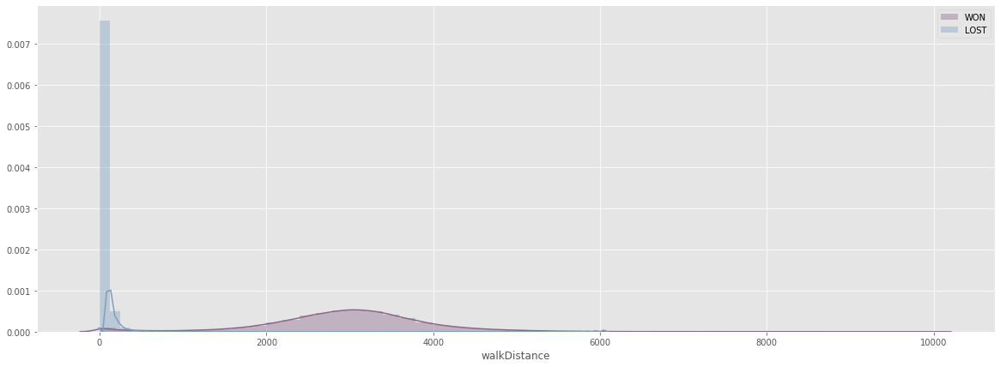

In [75]:
plt.figure(figsize=(20, 7))
sns.distplot(pw['walkDistance'], color="#8B668B")
sns.distplot(pl['walkDistance'], color="#7D9EC0")
plt.legend(['WON','LOST'])
plt.show()

通过观察，可以得到结论:

1、当`walkDistance = 0`时丢失最大匹配项。这意味着两件事:
   * 玩家在离开之前就被杀死了。
   * 玩家可能是想躲起来而不是冒险出去而被杀死。
   
2、显然，最大获胜记录的步行距离大于阈值(步行距离 > 2000)，显然是大于零。

3、上图数据显示开始时胜利和失败步行距离都在增加。在失败逐渐消失的时候，胜利开始达到顶峰。所以，随着步行距离的增加:
   * 增加获胜的可能性。
   * 输掉比赛的可能性更小。

所以，我们可以得出结论，步行距离是决定胜负的一个很好的衡量标准。超过一定的门槛(> 2000)，赢得游戏的机会增加。在游戏一开始就保持空闲/隐藏不是一个好的策略，并且会让玩家很容易被击倒。

* 找到步行距离和胜率的关系

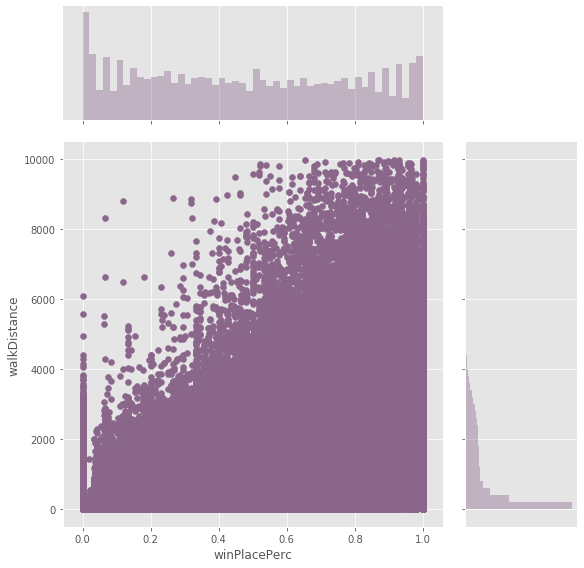

In [76]:
sns.jointplot(x='winPlacePerc', y='walkDistance', data=pbg, height=8, ratio=3, color="#8B668B")
plt.show()

通过观察，可以得到结论:

1、`winPlacePerc`和`walkDistance`是高度相关的。不难看出，前面热图(关系度高达0.81)中获得的信息是合理的。<br>
2、为了赢得胜利，必须通过移动和行走/奔跑来参与杀敌、造成伤害和获得倒下的敌人的武器装备。<br>
3、如果玩家不走一步或走短距离(非常接近于零)，他们更容易输掉比赛。<br>

* 找出胜利和失败的驾驶距离分布：

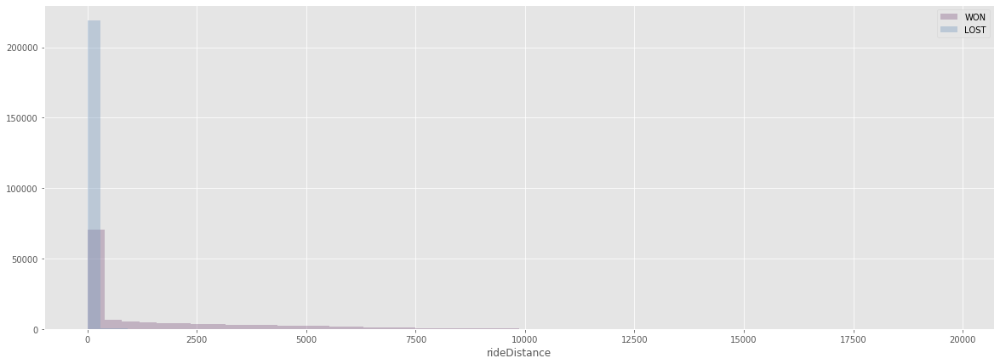

In [77]:
plt.figure(figsize=(20, 7))
sns.distplot(pw['rideDistance'], kde=False, color="#8B668B")
sns.distplot(pl['rideDistance'], kde=False, color='#7D9EC0')
plt.legend(['WON', 'LOST'])
plt.show()

通过观察，可以得到结论:

1、大多数优胜者的乘车距离为零。<br>
2、从递减趋势看，赢车次数明显随乘程的增加而减少。这是意料之中的，因为：<br>
   * 从另一个角度来看，存在道路死亡的风险。所以，开车比走路危险得多。
   * 因此，出现如此异常的零乘车距离的原因是玩家没有选择乘坐任何交通工具。
   
因此，我们可以得出结论，骑行距离并不是决定胜负的好方法。胜利的趋势随着骑距的增加而减少。

* 找到驾车距离与胜率的关系

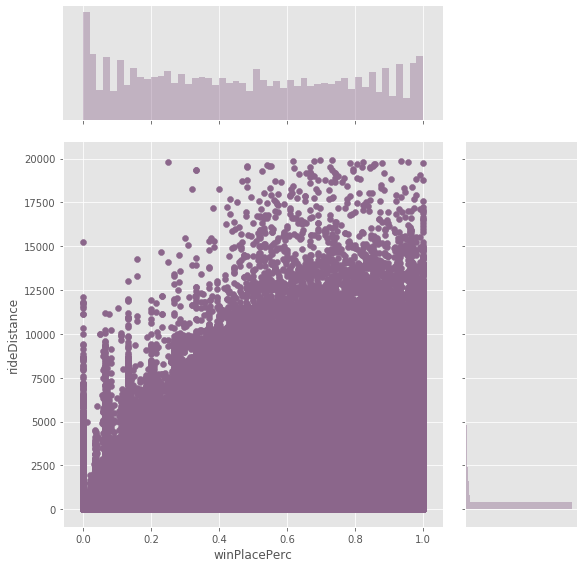

In [78]:
sns.jointplot(x='winPlacePerc', y='rideDistance', data=pbg, height=8, ratio=3, color="#8B668B")
plt.show()

显然`winPlacePerc`和`rideDistance`呈低相关。因此，从热图(0.34)中获得的信息是合理的。

* 找到胜利和失败的游泳距离分布

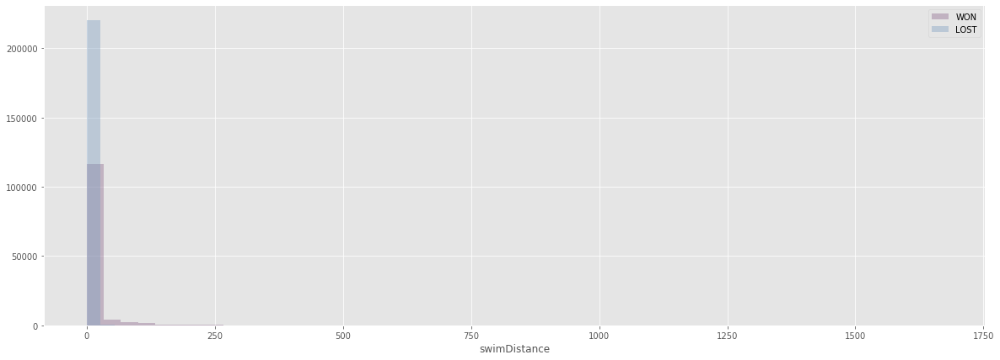

In [79]:
plt.figure(figsize=(20, 7))
sns.distplot(pw['swimDistance'], kde=False, color="#8B668B")
sns.distplot(pl['swimDistance'], kde=False,  color='#7D9EC0')
plt.legend(['WON','LOST'])
plt.show()

通过观察，可以得到结论:

1、几乎没有人游泳。<br>
2、即使是那些游泳的人也更容易失败而不是成功。<br>
3、获胜的机会随着距离的增加而减少。<br>

所以，游泳并不是决定胜负的好因素，并且获胜的机会随着距离的增加而减少。

* 找到游泳距离与胜率的关系

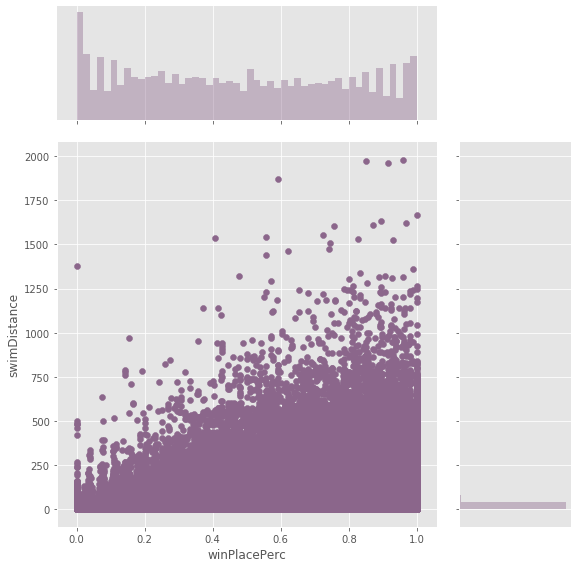

In [80]:
sns.jointplot(x='winPlacePerc', y='swimDistance', data=pbg, height=8, ratio=3, color="#8B668B")
plt.show()

正如预期的一样`swimDistance`和`winPlacePerc`有较差的相关性，热图数据(0.15)是合理的。

* 在零行走距离、零乘车距离和零游泳距离之后，有多少玩家赢得了他们的游戏？胜利是否伴随着交换的选择？

In [81]:
from plotly.subplots import make_subplots

# Percentage of zero walk distance
colors1 = ['rgb(158,202,225)','darksalmon']
colors2 = ['rgb(188,145,202)', 'darksalmon']
colors3 = ['rgb(247,173,13)','darksalmon']

fig = make_subplots(
    rows=1, cols=3,
    specs=[[{"type": "domain"}, {"type": "domain"}, {"type": "domain"}]]
)

fig.add_trace(go.Pie(labels=['ZERO WALK DISTANCE', 'OTHERWISE'],
                values=[pw[pw.walkDistance==0].shape[0], (pw.shape[0]-pw[pw.walkDistance==0].shape[0])],
                marker=dict(colors=colors1, line=dict(color='#000000', width=2))),
              row=1, col=1)

fig.add_trace(go.Pie(labels=['ZERO RIDE DISTNACE','OTHERWISE'],
                values=[pw[pw.rideDistance==0].shape[0],(pw.shape[0]-pw[pw.rideDistance==0].shape[0])],
                marker=dict(colors=colors2, line=dict(color='#000000', width=2))),
              row=1, col=2)

fig.add_trace(go.Pie(labels=['ZERO SWIM','OTHERWISE'],
                values=[pw[pw.swimDistance==0].shape[0], (pw.shape[0]-pw[pw.swimDistance==0].shape[0])],
                marker=dict(colors=colors3, line=dict(color='#000000', width=2)), opacity=0.75),
              row=1, col=3)

fig.update_layout(height=500, showlegend=True)
fig.show()



通过观察，可以得到结论:

1、大多数胜利记录在 步行距离> 0 (99.4%)。<br>
2、几乎一半的比赛胜利记录在 驾车距离= 0时(49.4%)。<br>
3、当 游泳距离= 0(84.9%)时，会记录相当数量的胜利。<br>

所以最好的策略是`walk`>`ride`>>`swim`

* `Heals`和`Boosts`对胜率有怎样的影响

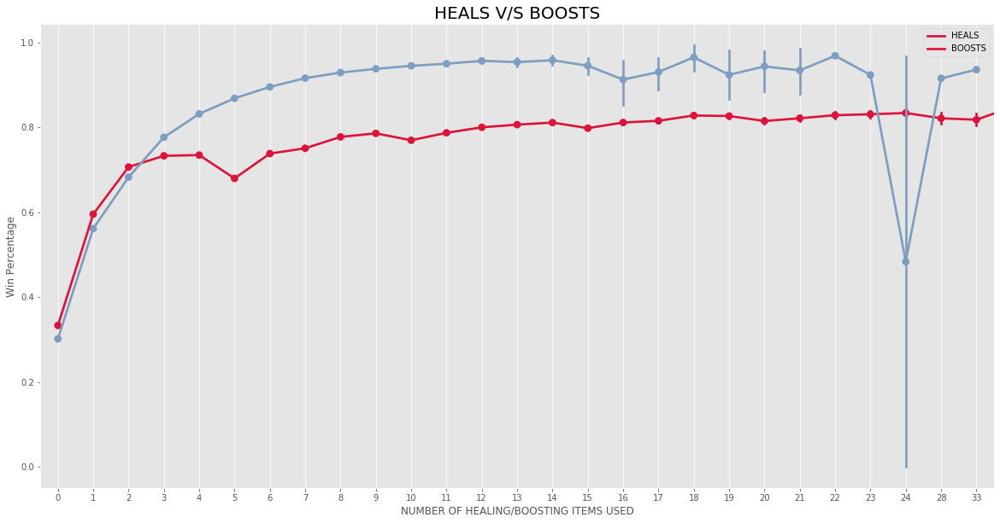

In [82]:
plt.figure(figsize=(20, 10))
sns.pointplot(x='heals',y='winPlacePerc', data=pbg, color='crimson', alpha=0.8)
sns.pointplot(x='boosts',y='winPlacePerc', data=pbg, color='#7D9EC0', alpha=0.8)
plt.legend(['HEALS','BOOSTS'])

plt.xlabel('NUMBER OF HEALING/BOOSTING ITEMS USED', fontsize=12)
plt.ylabel('Win Percentage', fontsize=12)
plt.title('HEALS V/S BOOSTS', fontsize=20)
plt.grid()
plt.show()

通过观察，可以得到结论:

1、**boost**几乎呈现上升趋势。随着**boost**的增加，**winPlacePerc**也普遍增加，它也确实是获得更多得分的方式。<br>
2、然而，**heals**却不是这样。它们表现出随机的波动，所以我们不确定它与胜利的确切关系，不过根据热力图可以看到其与胜率的关系度为0.43，不算太差。<br>


* 武器获得`weaponsAcquired`会对胜率有影响吗

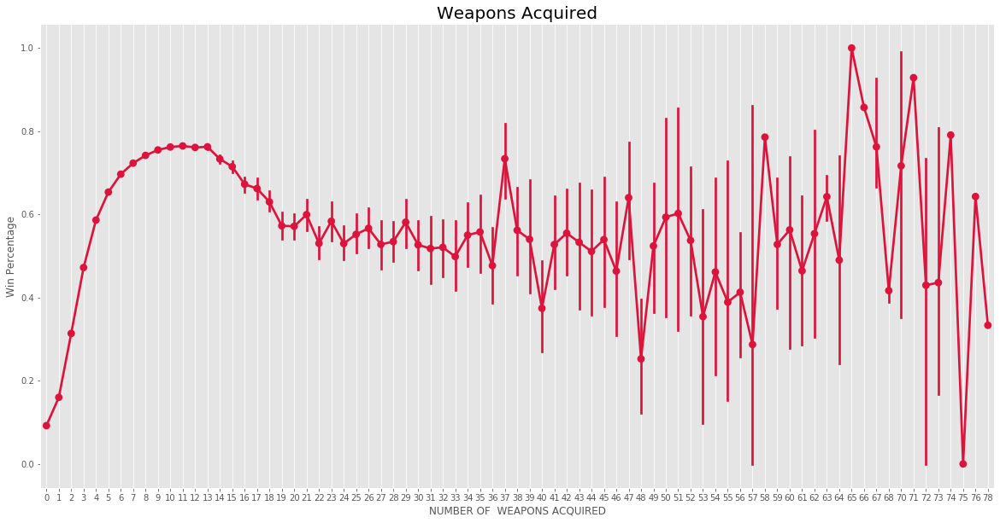

In [83]:
plt.figure(figsize=(20,10))
sns.pointplot(x='weaponsAcquired', y='winPlacePerc', data=pbg, color='crimson',alpha=0.8)
plt.xlabel('NUMBER OF  WEAPONS ACQUIRED', fontsize=12)
plt.ylabel('Win Percentage', fontsize=12)
plt.title('Weapons Acquired', fontsize=20)
plt.grid()
plt.show()

可以看到上图数据非常的波动<br>

通过观察，可以得到结论:

1、`weaponsAcquired`与`winPlacePerc`有低-中度的相关性。虽然它不是一个重要的影响因素，但却是一个确实存在影响的因素。

<a id="3.4"></a> <br>
> ### **3.4. 最终结论**

PUBG是一款风靡全球的多人游戏。每一个PUBG玩家都会以赢得一场胜利(用PUBG行话来说就是“大吉大利，今晚吃鸡”)带来的巨大的、无与伦比的快乐为目标。它让人放松，也让人上瘾。所以经过上面的分析和可视化内容，我总结了一些影响比赛胜利的最重要的因素，这也是影响预测玩家排名的重要因素，毕竟胜率将会直接影响玩家的排名。

* **在PUBG不要做什么?**

  1、除非你非常确定你的沟通技巧，否则不要选择`Squad-FPP`的比赛。分析表明，选择`Squad-FPP`的玩家往往会输掉更多的比赛。他们背后的一个主要原因可能是沟通错误，毕竟`Squad-FPP`中的玩家来自世界各地。<br>
  2、不要选择`duo`比赛，因为根据分析显示，没有一个被观察的玩家在双人比赛中获胜。<br>
  3、永远不要只杀一个人。因为根据分析显示，杀敌少于2次的玩家会失败。<br>
  4、不要从游戏一开始就躲起来。因为根据分析表明，零步行距离的人失败率更高。<br>
  5、尽量不要驾车，因为你有被公路撞死的危险。另外不要游泳，分析表明，他们对胜利的起不到太大的作用。<br>


* **在PUBG中要怎么做才能赢?**

  1、选择`Squad`比赛。因为根据分析显示，他们是第三大最受欢迎的比赛类型，同时比`Squad`更能保证胜利。这是因为，在`squad`比赛中，你可以选择自己组队而不是随机组队，如果你和朋友一起比赛，交流就会更容易。<br>
  2、选择`Duo-FPP`配对，因为分析表明它们的胜率最高。<br>
  3、在不被枪杀的情况下尽可能多地杀人，分析表明，杀敌的数量和获胜的比例是中度相关的。如果你觉得情况安全，就有策略地杀人。比如，如果你有一把散弹枪，那就用散弹枪和别人打架，而不是用高级别的武器。你杀的人越多，你收集的武器装备就越多)<br>
  4、只要你没有处于危险之中，分析表明，施加更多的伤害可以展示一个玩家的技能，通常可以确保一个好的分数。<br>
  5、比起游泳或驾车，我更推荐步行或跑步。数据告诉我们，取得胜利的玩家都伴随着一定步行距离。
  6、沉迷于拾起更多的`boosts`和`heals`，因为这两者都与胜利紧密相关。
  7、明智地选择战斗,与你确信你能开枪击倒的敌人战斗。